# Assignment #3 - Reinforcement Learning

### <font color="red"> DUE: Nov 1 (Thursday) 11:00 pm </font>  

<font color="blue"> Divya Patel </font>

# I. Overview

* In this assignment, we will learn how to make reinforcement agent using reinforcement algorithm like Q learning algorithm and SARSA. 
* I am going to make reinforcemnet agent for two problem maze problem and poker game. Also, I am going to do expriment and try to tune parameter like discount factor, alpha learning rate for particular algorithm. 

# II. Problems 

## A. Maze Problem (Practice)



## Explanation of Maze Preoblem and GridWord class:

* It is quite simple problem, we have given starting position in grid which have open space , Wall and Goal position. Our goal is to reach to goal state from starting position while visiting minimum state in between.
* For this we have make Gridworld class, in which there are lot of method we have written which we are going to use while making our Rlagent for solving this agent. 
* First we are intializing the class and read the text file. Here we have for action from any state to go upward, downward, left or right. Method which are in this class is given below:
 1. get_curl_state : It will return current state.
 2. get_size : It will return sie of environment
 3. print_map : It will print the maze
 4. read_map : It will read the file given by us and return the grid array
 5. check_state : It will check that our state don't go out of the maze and given state is valid or not means coordinate is valid for given grid. If for particular action we are going out of maze then our next state will be our current state only. We just give negative reward. For valid state it will return current character
 6. init : Here if while making object of this class if we don't give starting position, it will intialize starting position to [0,0] and also it will check that starting position given by us is valid using check_state and it is open space or not. If any of this condition is violate, it will raise value error and print "Invalid state for init".
 7. next: It will update current state s with next state s1 for given action. Also it will return reward for that particular action. If for particular action next state is wall or invalid state, it will give reward of -5 and stay at current state only. If it will goal state then it will give reward of 30 point and update current state to this state . If it will be open space then it will return reward if -1 and update current state to it.
 8. is_goal : It is only checking that given state is goal state or not.
 9. get_action : It will return action which we can take. 

In [9]:
import collections
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### Sample Grid Environment File

Simple text file with three characters, 'O', 'H', and 'G'.
- 'O': open space
- 'H': Wall or obstacles
- 'G': Goal location 

In [10]:
%%bash 
cat grid.txt

Couldn't find program: 'bash'


### GridWorld Class


In [11]:
# maze example

class GridWorld:
    """ Grid World environment
            there are four actions (left, right, up, and down) to move an agent
            In a grid, if it reaches a goal, it get 30 points of reward.
            If it falls in a hole or moves out of the grid world, it gets -5.
            Each step costs -1 point. 

        to test GridWorld, run the following sample codes:

            env = GridWorld('grid.txt')

            env.print_map()
            print [2,3], env.check_state([2,3])
            print [0,0], env.check_state([0,0])
            print [3,4], env.check_state([3,4])
            print [10,3], env.check_state([10,3])

            env.init([0,0])
            print env.next(1)  # right
            print env.next(3)  # down
            print env.next(0)  # left
            print env.next(2)  # up
            print env.next(2)  # up

        Parameters
        ==========
        _map        ndarray
                    string array read from a file input
        _size       1d array
                    the size of _map in ndarray
        goal_pos    tuple
                    the index for the goal location
        _actions    list
                    list of actions for 4 actions
        _s          1d array
                    current state
    """
    def __init__(self, fn):
        # read a map from a file
        self._map = self.read_map(fn)
        self._size = np.asarray(self._map.shape)
        self.goal_pos = np.where(self._map == 'G')

        # definition of actions (left, right, up, and down repectively)
        self._actions = [[0, -1], [0, 1], [-1, 0], [1, 0]]
        self._s = None

    def get_cur_state(self):
        return self._s

    def get_size(self):
        return self._size

    def read_map(self, fn):
        grid = []
        with open(fn) as f:
            for line in f:
               grid.append(list(line.strip()))
        return np.asarray(grid)

    def print_map(self):
        print( self._map )

    def check_state(self, s):
        if isinstance(s, collections.Iterable) and len(s) == 2:
            if s[0] < 0 or s[1] < 0 or\
               s[0] >= self._size[0] or s[1] >= self._size[1]:
               return 'N'
            return self._map[tuple(s)].upper()
        else:
            return 'F'  # wrong input

    def init(self, state=None):
        if state is None:
            s = [0, 0]
        else:
            s = state

        if self.check_state(s) == 'O':
            self._s = np.asarray(s)
        else:
            raise ValueError("Invalid state for init")

    def next(self, a):
        s1 = self._s + self._actions[a]
        # state transition
        curr = self.check_state(s1)
        
        if curr == 'H' or curr == 'N':
            return -5
        elif curr == 'F':
            warnings.warn("invalid state " + str(s1))
            return -5
        elif curr == 'G':
            self._s = s1
            return 30
        else:
            self._s = s1
            return -1
        
    def is_goal(self):
        return self.check_state(self._s) == 'G'
            
    def get_actions(self):
        return self._actions

In [12]:
env = GridWorld("grid.txt")
env.print_map()

[['O' 'O' 'O' 'O' 'O' 'O' 'O' 'H' 'O' 'O']
 ['O' 'O' 'H' 'H' 'O' 'O' 'O' 'H' 'H' 'H']
 ['O' 'H' 'O' 'O' 'O' 'H' 'O' 'O' 'O' 'O']
 ['O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O']
 ['H' 'H' 'H' 'O' 'H' 'H' 'O' 'O' 'H' 'O']
 ['O' 'O' 'O' 'G' 'O' 'O' 'O' 'O' 'O' 'O']
 ['H' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O']
 ['O' 'O' 'O' 'O' 'H' 'O' 'O' 'O' 'O' 'O']
 ['O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O']
 ['O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O' 'O']]


In [13]:
# top-left to (0,0)
def coord_convert(s, sz):
    return [s[1], sz[0]-s[0]-1]

## B. One-Card Poker  

![](http://www.poker-vibe.com/poker/terms/case-card/Case-Card.jpg)

<font color="red"> Game Introduction and Rules: </font>
1. This is a 1-card poker game. Where each player can blindly bet from 0 (fold), 1, 2 or 3 in the first round. In the next round only the player who havent matched the max amount( from all the players) will be given a chance to bet additional amount to match or fold. 


2. Each player will be able to see his/her own card and the total pot balance and all other player's balance and their current bet on for the round i.e this is what you can call the current state of the game. <br>

    a. <font color="red"> Example1 </font>: 3 players in game i.e. player1, computer1, computer2. First round, player1        bets 3, computer1 bets 2 and computer2 bets 1. Next round only computer1 and computer2 will be given a chance          to match the bet as player1 has max bet so computer1's available actions will be (0, 1) and computer2's                available actions will be (0, 2).<br>
    
    b. After they match or fold the result will be given. <br>
    
    c. This case is applicable for player1 being the one who needs to match. <font color="red"> Example2 </font>: 3          players in game i.e player1, computer1, computer2. First round, player1 bets 1, computer1 bets 2 and                  computer2 bets 3. Next round only player1 and computer1 will have chance to bet and match or fold. <br>
       
    d. The examples described above will be 1 round each, this will continue until player1 losses all the money or            computer1 and computer2 will be out of money. <br>
    
This is a local version of the game, your final competition if you decide to participate will be hosted on server. The local version, you can add multiple computer players in the game but only single agent.

This way you can train your agent to play against 1,2,3,4 


## Explanation Of Poker Problem and Explanation of Poker class:

* It is just like Poker but with some different rules which makes it little easy for making rlagent for that. The rules are mentioned as above, we can bet 0(fold),1,2,3. Every player has to reach maximum bet to stay in a game. We have information about our card, total pot balance, our balance, our bet for the current bet, all other player's balance and their current bet on for the round. We can use this information as our states. The only player left with money when all other have no money will win obviously. Our goal is to make rlagent who win the whole game.
* Class player is for creating player. We can create as many as we want. Just we have to make sure, there is only one non-computer player. While making object of player class, we provide imformation like player name, starting balance and is it computer or not. Get_info will print player name, player card, player total current balance and it is betting or not. Here draw_card is just returning random no between 1 to 13 just like dealer in poker.
* Now come to poker class. Poker class take no of player as a parameter. Poker class is environment of the game. For this  game we have only four action as mention in poker class intialize method also we make a list of all_players. We can bet 0 means fold or 1 or 2 or 3. Now all other method are mention below.
 1. Add_player : It take player_class as parameter. First we will check that it is not in the all_player list and we do not reach the maximum player then we will append that player_class in the list all_players and also decrease the counter of total player by one. Also we will allow non computer player if they are no computer player till now otherwise we will raise exception and overwrite that player. If we reach maximum player count then we throw exception of Maximum number of player allowed this much only. You can increase the player count while initializing the environment.
 2. check and remove player : It is method for removing player which have balance less than or equal to 1. Also to keep track make list and append every player is removed by us.
 3. Deal : It is just like dealer of poker game. First it will reset the pot balance and np of turn to zero then it will check player who has no money left and remove them. Then if there is only one player left it will reset the game. Otherwise it will deal for remaining player in all_player list and decrease all that players pot balance by one.
 4. get_current_state : It will return dictionary which has information of all computer player's total balance and bet for current round. Also it will have information of total current pot value and player's card, total balance and current bet.
 5. get_valid_actions : It will return actions which we can do means bet we can make in current state. It will check first that it is the same player as we define as non computer player otherwise it will throw exception.
 6. print_action : It is simple funtion just take player name and the action which he is taking as parameter and return the action with player's name. For example if player1 choose to take action 0 then it will print "player1 fold".
 7. computer_play : It will make a list which has all computer player in it. Then it will check first availabe action that player can make at state using get_valid_actions method. It will choose random action from that possible actions. If it decided to not fold and it has not match the max_bet in second round then it will match the maximum bet.
 8. get_player : It will just return given player which we pass in parameter if it is in all_player list otherwise print "Invalid player"
 9. taken_action : We pass player name and particular action that we want to take in this method. It will increase the number of turn and check if he want to fold then we deactivate the player otherwise we will decrease player's total balance with taken_action, increase the total bet by action_taken and update current_bet of player by taken_action.
 10. check_game : It will just check game is over or still going on.
 11. return_winner : It will return the player name who has high card among all the participant player.
 12. settel_balance : It is very key method. It first see who are the winner after game is finished. If there are draw between two or more player then it will share the money equally. It will update all player's balance also. If winner is only player or computer, it will update balance accordingly. It is simple mathamatics. Reward will be equal to amount money player won and it will be negative amount of money player loss if we loss money. It will return reward atlast.
 13. check_game_return_reward : This method take no of round as parameter. It will return game status , reward and winner after that round. Also it will update winner, reward and balance of player for every possible situation at that round.
 14. update_match : It updates max_bet when someone total bet surpass the current max_bet.
 15. check_computer_status : It will check that are there any computer players who are active and want to make bet to reach max_bet.
 16. player_play : It is main meethod which use most of the upper method in this class. It take player_name and action_taken as parameterof this method. It will check everything and update all value respected to action_taken from current state and return update current state, reward given for particular action and game staus(it is finish or still going on.)

## One-Card Poker Environment

In [14]:
import copy
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
def draw_card():
    return deck[np.random.randint(1, 13)]

In [15]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10, is_computer = 0)
        Above declaration will be for your agent. Only one non-computer
        player allowed in the local poker instance.
        However, you can create as many as you want computer_players 
        (test for 3 players but you can try more) i.e
        computer = Player("computer", start_balance = 10, is_computer = 1).
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10, is_computer = 0):
        self.player_name = player_name
        self.card = None
        self.total_balance = start_balance
        self.current_bet = 0
        self.is_computer = is_computer
        self.is_active = 0
        self.number_of_turn = 0
        self.match_bet = False
    
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))
        print("Player is_active: {}".format(self.is_active))
        

In [16]:
class Poker():
    """
        Poker class will be the environment. 
        Important functions for users:
        1. Init Poker class i.e poker = Poker(number_of_player = 2)
           <Please dont add more than the number you declare here)
        2. add_player(player1) - adds player1 object to the game.
        3. get_current_state - gets the current state of the env
           {'other_stats': [[9, 1] ,[9, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9, 1]}
           other_stats will contain the opponent information's balance and their current bet
           total_pot_balance will have total bet played by all players
           player_stats will contain player_card, player total balance, player current bet
        4. get_valid_actions -  returns the valid action available for the player
           based on balance and which round the player is in. You should take actions
           based on the return value.
           
    
    """
    def __init__(self, number_of_player = 2):
        self.all_players = []
        self.total_players = number_of_player
        self.total_pot_balance = 0
        self.player = None
        self.actions = [0, 1, 2, 3]
        self.number_of_turn = 0
        self.max_bet = 0
        
    def add_player(self, player_class):
        if player_class not in self.all_players and self.total_players > 0:
            self.all_players.append(player_class)
            self.total_players -= 1
            if player_class.is_computer == 0:
                if self.player == None:
                    self.player = player_class
                else:
                    raise Exception("Will override current player ! Only one non-computer player allowed !")
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.all_players)))
    
    def check_and_remove_players(self):
        player_remove, game_end = [], False
        for _player in self.all_players:
            if _player.total_balance <= 1:
                player_remove.append(_player)
        if len(player_remove) > 0:
            if self.player not in player_remove:
                for player in player_remove:
                    print("Removing player: {} due to insufficient funds !!".format(player.player_name))
                    self.all_players.remove(player)                    
            else:
                print("Player doesnt have balance !")
                game_end = True
                
                
    def deal(self):
        reset_game = False
        self.total_pot_balance = 0
        self.number_of_turn = 0
        
        if self.check_and_remove_players():
            reset_game = True
        else:
            if len(self.all_players) == 1:
                reset_game = True
            else:
                for _player in self.all_players:
                    if _player.total_balance > 1:
                        _player.card = draw_card()
                        _player.total_balance -= 1
                        _player.current_bet = 1
                        _player.is_active = 1
                        _player.number_of_turn = 0
                        _player.match_bet = False
                        self.total_pot_balance += 1
                        self.max_bet = 0
                    else:
                        print("{} can no longer play the game !".format(_player.player_name))
                        reset_game = True        
        return reset_game
        
    def get_current_state(self):
        current_state_dict = {}
        current_state_dict['other_stats'] = [[_player.total_balance,_player.current_bet] for _player in self.all_players if _player != self.player]
        current_state_dict['total_pot_balance'] = self.total_pot_balance
        current_state_dict['player_stats'] = [self.player.card, self.player.total_balance, self.player.current_bet]
        return current_state_dict
    
    def get_valid_actions(self, player_name):
        list_player = [_player for _player in self.all_players if _player.player_name == player_name]
        if len(list_player) == 1:
            player = list_player[0] 
            if player.number_of_turn == 0:
                if player.total_balance > 3:
                    actions =  [0, 1, 2, 3]
                elif player.total_balance <= 3:
                    if player.total_balance <= 1:
                        actions = [0]
                    elif player.total_balance > 1 and player.total_balance <= 2:
                        actions =  [0, 1]
                    else:
                        actions = [0, 1, 2]
            else:
                possible_max_bet = player.total_balance - (self.max_bet - (player.current_bet - 1))
                if possible_max_bet >= 2:
                    actions = [0, self.max_bet - (player.current_bet - 1)]
                else:
                    actions = [0]                        
            return actions
        else:
            raise Exception("Invalid player name! Use the player name defined while initialzing the environment")
    
    def print_actions(self, player, action):
        if action == 0:
            print("{} folds".format(player))
        else:
            print("{} plays {}.".format(player, action))
            
    def computer_play(self):
        list_player = [_player for _player in self.all_players if _player.player_name != self.player.player_name and _player.is_active == 1 and _player.match_bet == False]
        for player in list_player:
            actions_available = self.get_valid_actions(player.player_name)    
            print("Available actions for: {} are {}".format(player.player_name, actions_available))
            action_taken = actions_available[np.random.randint(len(actions_available))]
            self.print_actions(player.player_name, action_taken)
            if self.max_bet == 0 and action_taken != 0 or self.max_bet < action_taken:
                self.max_bet = action_taken
            self.take_action(player.player_name, action_taken)
    
    def get_player(self, player_name):
        return_player = [player for player in self.all_players if player.player_name == player_name]
        if len(return_player) != 1:
            print("Invalid Player")
            return None
        else:
            return return_player[0]
        
    def take_action(self, player_name, action_taken):
        player = self.get_player(player_name)
        player.number_of_turn += 1
        if action_taken != 0:
            player.total_balance -= action_taken
            player.current_bet += action_taken
            self.total_pot_balance += action_taken
            player.is_active = 1
        else:
            player.is_active = 0
            
    def check_game(self):
        game_over = True
        if np.sum([_player.is_active for _player in self.all_players if _player != self.player]) > 0:
            game_over = False
        return game_over
     
    def return_winner(self, players):
        max_card = np.max([_player.card for _player in players])
        return [_player for _player in players if _player.card == max_card]
            

    def settle_balance(self, winner):
        reward = 0
        if winner == "draw":
            active_player = [_player for _player in self.all_players if _player.is_active]
            if len(active_player) == 0:
                print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in self.all_players]))
                winning_players = self.all_players
            else:
                print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in self.all_players if _player.is_active]))
                winning_players = self.return_winner(active_player)
                
            per_player_share = self.total_pot_balance / len(winning_players)
            for _player in winning_players:
                _player.total_balance += per_player_share
            if self.player in winning_players:
                reward = per_player_share
            else:
                reward = -self.player.current_bet
            
                
        if winner == "player":
            self.player.total_balance += self.total_pot_balance
            reward = self.total_pot_balance
            winning_players = [self.player]
            
        if winner == "computer":
            active_player = [_player for _player in self.all_players if _player != self.player and _player.is_active]
            winning_players = self.return_winner(active_player)
            per_player_share = self.total_pot_balance / len(winning_players)
            for _player in winning_players:
                _player.total_balance += per_player_share
            reward = -self.player.current_bet
            
        print("Printing winning players: {}".format(' '.join([player.player_name for player in winning_players])))
        print("Reward : {}".format(reward))
        return reward
        
    def check_game_return_reward(self, round_num):
        print("Check results for Round Number: {}".format(round_num))
        if self.check_game() and self.player.is_active == 0:
            print("Computer folds, Player folds !")
            game_over = True
            winner = "draw"
            reward = 0
            return game_over, reward, winner 
        
        elif self.check_game() and self.player.is_active:
            print("Computer folds, Player active !")
            game_over = True
            reward = self.total_pot_balance
            winner = "player"
            return game_over, reward, winner 
        
        elif not self.check_game() and self.player.is_active == 0:
            print("Computer active, Player folds !")
            game_over = True
            reward = -self.player.current_bet
            winner = "computer"
            return game_over, reward, winner 

        if round_num == 1:
            print("Computer active, Player active ! ")
            game_over = False
            reward = 0
            winner = "draw"
            return game_over, reward, winner 
        
        else:
            print("Computer active, Player active in Round 2 ! End game now !")
            game_over = True
            active_players = [player for player in self.all_players if player.is_active]
            print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in active_players]))
            winning_players = self.return_winner(active_players)
            if self.player in winning_players:
                if len(winning_players) > 1:
                    reward = self.total_pot_balance / len(winning_players)
                    winner = "draw"
                else:
                    reward = self.total_pot_balance
                    winner = "player"
            else:
                reward = -self.player.current_bet
                winner = "computer"

            return game_over, reward, winner 
            

    
    def update_match(self):
        for player in [player for player in self.all_players if player.current_bet - 1 == self.max_bet]:
            player.match_bet = True
    
    def check_computer_status(self):
        computer_play = False
        if len([player for player in self.all_players if player.is_computer == 1 and player.match_bet == False and player.is_active == 1]) > 0:
            computer_play = True
        return computer_play
    
    def player_play(self, player_name, action_taken):
        game_over = False
        reward = 0  
        winner = None
        self.number_of_turn += 1
        
        if self.number_of_turn == 1:
            if self.max_bet == 0 and action_taken != 0 or self.max_bet < action_taken:
                self.max_bet = action_taken
            self.print_actions(player_name, action_taken)
            self.computer_play()
            self.take_action(player_name, action_taken)
            self.update_match()
            if self.player.is_active:
                if self.player.match_bet and not self.check_computer_status():
                    print("Player and Computer both Bet Max and match !")
                    _, reward, winner = self.check_game_return_reward(round_num=1)
                    game_over = True
            else:
                if self.check_computer_status():
                    print("Player folds, computer players are active, they will play among themselves !")
                    self.computer_play()
                game_over, reward, winner = self.check_game_return_reward(round_num=1)
                
            if game_over:
                print("Winner: {}".format(winner))
                new_reward = self.settle_balance(winner)
                if winner == "draw":
                    reward = new_reward
            else:
                if self.player.match_bet and self.check_computer_status():
                    print("Player Bet Max, computer will match now !")
                    self.computer_play()
                    game_over, reward, winner = self.check_game_return_reward(round_num=2)
                    print("Winner: {}".format(winner))
                    new_reward = self.settle_balance(winner)
                    if winner == "draw":
                        reward = new_reward
                    
            return self.get_current_state(), reward, game_over
        
        if self.number_of_turn == 2:
            self.print_actions(player_name, action_taken)
            self.take_action(player_name, action_taken)
            if self.check_computer_status():
                self.computer_play()
            game_over = True
            _, reward, winner = self.check_game_return_reward(round_num=2)
            print("Winner: {}".format(winner))
            new_reward = self.settle_balance(winner)
            if winner == "draw":
                reward = new_reward
        
        return self.get_current_state(), reward, game_over
    
    

### Example Run with Random Players

In [17]:
poker = Poker(number_of_player=3)
player1 = Player("prajval", start_balance = 10, is_computer =  0)
computer1 = Player("computer1", start_balance = 10, is_computer = 1)
computer2 = Player("computer2", start_balance = 10, is_computer = 1)
poker.add_player(player1)
poker.add_player(computer1)
poker.add_player(computer2)
while not poker.deal():
    print("-"*50)
    print("Deal Start!")
    print("Start State: {}".format(poker.get_current_state()))
    actions = poker.get_valid_actions("prajval")
    print("Available actions for: prajval are {}".format(actions))
    action_taken = actions[np.random.randint(len(actions))]
    result = poker.player_play("prajval", action_taken)
    while not result[-1]:
        actions = poker.get_valid_actions("prajval")
        print("Available actions for: prajval are {}".format(actions))
        action_taken = actions[np.random.randint(len(actions))]
        result = poker.player_play("prajval", action_taken)
    print("Final Result: {}".format(result))
    print("*"*50)
    

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prajval plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Available actions for: computer2 are [0, 1, 2, 3]
computer2 plays 2.
Available actions for: prajval are [0, 1]
prajval plays 1.
Available actions for: computer2 are [0, 1]
computer2 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('prajval', 9), ('computer1', 8), ('computer2', 7)]
Winner: player
Printing winning players: prajval
Reward : 12
Final Result: ({'other_stats': [[6, 4], [6, 4]], 'total_pot_balance': 12, 'player_stats': [9, 18, 4]}, 12, True)
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [5, 1]], 'total_pot_b

In [18]:
poker.deal()

Player doesnt have balance !
prajval can no longer play the game !


True

In [19]:
poker.get_current_state()

{'other_stats': [[26.0, 1]],
 'total_pot_balance': 1,
 'player_stats': [9, 1.0, 2]}

In [20]:
poker.get_valid_actions("prajval")

[0, -1]

In [21]:
poker.player_play("prajval", 1)

prajval plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('prajval', 9), ('computer1', 7)]
Printing winning players: prajval
Reward : 4.0


({'other_stats': [[24.0, 3]],
  'total_pot_balance': 4,
  'player_stats': [9, 4.0, 3]},
 4.0,
 True)

# III. Methods

* Decide your TD learning approach: SARSA or Q-learning?: In reinforcemnt learning to solve MDP problem having large number of state is very hard. It's computation time increase like exponentially. Also dynamic programmnig cant handle it. So, to solve this kind of problem, we come up with TD learnin. It just consider current state and probable next state without considering transmission probability. In this we update Q value of state using seeing error by finding difference between Q value of next state when taking an action and old Q value of current state for that action. We use parameter like gamma (discount factor) and alpha (learning rate). TD learning has two different method 
 1. **SARSA** : It is on policy control. It means "Learn on job". We learned about policy from only it's own experince sample policy. But the advantage is, it will allow to explore more environment state as compare to Q-learnig. So there will be  no case like it will stuck at some state for infinity time because for every action there are so much negative reward. It is beneficial because there is possibility of getting big reward after three four states. We update Q value in this using formula given below.
          Q(st,at)←Q(st,at)+α(Rt+1+γQ(st+1,at+1)−Q(st,at))
 
 2. **Q-Learning** : It is off policy control. It means "Look over someone else shoulder". It will learn about policy from differnt experince done by other people on same environment. So, it is very fast compare to SARSA. It always behave greedy and take maximum Q value of next state. So disadvantage of this algorithm is, there may be some state will not be visited or exoplore by agent. It will converge fast. For example, in maze problem if our intial state is in center very nearby goal state then our agent will not explore edges of our maze. We update Q value in this using formula given below.
          Q(st,at)←Q(st,at)+α(Rt+1+γmaxQ(st+1,a)−Q(st,at))
  
 
### Explain the code:

1. Maze Agent : 
 * First in init method, I just make a array Q with dimension according my maze and assign every value to zero. After I make epsilon greedy function which will take action randomly sometimes, it depends on our epsilon value. It helps us to explore the environment more then just take greedy action after every iteration. For training agent using saras method , yiu have to give saras= True in parameter and for Q-Learning q_learning = True. We make rtrace and step which will keep track of reward given in each iteration and step which we are taking for each itearation respectively. 
 * Here , after reaching final state we  are assigning 0 value to final Q function for goal state and particular action which we take.
 * In test just we are taking intial state as parameter then we are taking action which has highest Q value in this state and then we are going to next state. We will follow this process still we reach the goal state.

2. Poker Agent: 
 * In this we are doing most of the thing same as Maze agent. First step is to make Q array with dimension of states and start the game with two player . This agent can only play useful when we want to play between two player. I make it like that only. One player will be computer and one will be agent. 
 * I am taking fourstates. First state is card that I have. Second state will be total balance of pot. While making q, I take care that it will cover all state range. Like total pot value can be between 1 to 20. Third state, which I am taking is computer' bet. I comsider it as a state but It is not that important in my point of view. We can avoid it. Fourth state is our bet. 
 * I am using Q-learning only to train this agent. First we make two player assign them staring balance and all using poker class's method. Then we start the game and it will use epsilon greedy method to choose the action from the state. It will also update the Q value using formula of Q-learning which is given above. It will repeat this process till one of the player goes out of money. This whole process will done as much time as our maxiter.
 * Now in test we are doing same. First we will start game between two player. Intial state will be given and from that state we will take action which Q is maximum for that state. Here action will what we are betting. It will use the train Q value to take action. We will valid the action using get_valid_actions method.



## RLAgent for Maze

Read the understand the codes below and explain it with your words. 
Do NOT forget to answer the question. 

In [22]:
class RLAgent: 
    """
        Reinforcement Learning Agent Model for training/testing
        with Tabular function approximation
        
    """
    
    def __init__(self, evn):
        self.env = env
        self.size = env.get_size()
        self.n_a = len(env.get_actions())
        # self.Q table including the surrounding border
        self.Q = np.zeros((self.size[0], self.size[1], self.n_a))
    
    def epsilon_greed(self, epsilon, s):
        # TODO: Finish this function
        if np.random.rand() < epsilon:
            return np.random.randint(self.n_a)
        else:
            return np.argmax(self.Q[s])
    
    def train(self, start, **params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon= params.pop('epsilon', 0.1)
        maxiter= params.pop('maxiter', 1000) 
        maxstep= params.pop('maxstep', 1000)
        sarsa = params.pop('sarsa',False)
        q_learning = params.pop('q_learning',False)
        env = self.env
        # init self.Q matrix
        self.Q[...] = 0
        self.Q[self.env._map == 'H'] = -np.inf
        
        # online train
        # rewards and step trace
        rtrace = []
        steps = []
        for j in range(maxiter):

            env.init(start)
            s = env.get_cur_state()
            # selection an action
            a = self.epsilon_greed(epsilon, tuple(s))

            rewards = []
            trace = np.array(coord_convert(s, self.size))
            # run simulation for max number of steps 
            for step in range(maxstep):
                # move
                r = env.next(a)
                s1 = env.get_cur_state()
                a1 = self.epsilon_greed(epsilon, tuple(s1))
                rewards.append(r)
                trace = np.vstack((trace, coord_convert(s1, self.size)))

                # TODO: FINISH SARSA/Q-learning Rule here
                # update self.Q table 
                if sarsa:
                     self.Q[tuple(s)][a]  += alpha * (r + gamma * self.Q[tuple(s1)][a1] - self.Q[tuple(s)][a])
                if q_learning:
                    self.Q[tuple(s)][a] += alpha * (r + gamma * np.max(self.Q[tuple(s1)]) - self.Q[tuple(s)][a])
                
                if env.is_goal(): # reached the goal
                    # TODO: Why is this zero? Describe this in your code explanation.
                    self.Q[s1[0], s1[1], a1] = 0
                    break

                s = s1
                a = a1

            rtrace.append(np.sum(rewards))
            steps.append(step+1)
        return rtrace, steps, trace # last trace of trajectory

    def test(self, start, maxstep=1000):
        # TODO: Add your test routine that exmines learned policy
        #      Using the learned policy, generate the trajectory of 
        self.env.init(start)
        trace = [] 
        print(self.env.get_cur_state())
        for _ in range(maxstep):
            if self.env.is_goal():
                s = self.env.get_cur_state()
                trace.append(coord_convert(s,self.size))
                break
            else:
                s = self.env.get_cur_state()
                trace.append(coord_convert(s,self.size))
                a = np.argmax(self.Q[tuple(s)])
                r = self.env.next(a)
        return trace            

In [23]:
env = GridWorld('grid.txt')

## RLAgent for One-Card Poker

In [24]:
class PkAgent:

    def __init__(self):
        self.env = Poker(number_of_player=2)
        player1 = Player("agent", start_balance = 10, is_computer =  0)
        computer1 = Player("computer1", start_balance = 10, is_computer = 1)
        self.env.add_player(computer1)            
        self.env.add_player(player1)

        self.p_name = self.env.player.player_name
        self.state_dict =  self.env.get_current_state()
        self.Q = np.zeros((14,1+self.state_dict['player_stats'][1]*2,5,5))
    
    #I am assuming that we will play game between two player only. One computer and one myself 
    def epsilon_greed(self, epsilon, s):
        n_a = self.env.get_valid_actions(self.env.player.player_name)
        if np.random.rand() < epsilon:
            return np.random.randint(len(n_a))
        else:
            return np.argmax(self.Q[s][n_a])
     
    def train(self, **params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon= params.pop('epsilon', 0.1)
        maxiter= params.pop('maxiter', 1000) 
        maxstep= params.pop('maxstep', 1000)
        q_learning = params.pop('q_learning',False)
        
        print(self.env.player.player_name)
        # init self.Q matrix
        self.Q[...] = 0
       
        
        # online train
        for j in range(maxiter):
            print("*"*60,)
            self.env = Poker(number_of_player=2)
            player1 = Player("agent", start_balance = 10, is_computer =  0)
            computer1 = Player("computer1", start_balance = 10, is_computer = 1)
            self.env.add_player(computer1)            
            self.env.add_player(player1)
#             print(self.p_name)

            while not self.env.deal():
                state_dict = self.env.get_current_state()
                s = (int(state_dict['player_stats'][0]),int(state_dict['player_stats'][1]),int(state_dict['other_stats'][0][1]))
                # selection an action
                init_actions = self.env.get_valid_actions(self.p_name)
                a = self.epsilon_greed(epsilon, s)
                result = self.env.player_play(self.env.player.player_name,self.env.get_valid_actions(self.env.player.player_name)[a])
                reward = result[1]

                while result[2] == False:
                    state_dict1 = self.env.get_current_state()
                    s1 = (int(state_dict1['player_stats'][0]),int(state_dict1['player_stats'][1]),int(state_dict['other_stats'][0][1]))
                    a1 = self.epsilon_greed(epsilon, s1)
                    result = self.env.player_play(self.env.player.player_name,self.env.get_valid_actions(self.env.player.player_name)[a1])
                    reward = result[1]

                state_dict2 = self.env.get_current_state()
                s2 = (int(state_dict2['player_stats'][0]),int(state_dict2['player_stats'][1]),int(state_dict2['other_stats'][0][1]))
                
                if q_learning:
                    self.Q[s][init_actions[a]] += \
                        alpha*(reward + gamma*np.max(self.Q[s2]) - self.Q[s][init_actions[a]])
        
    def test(self):
        self.env = Poker(number_of_player=2)
        player1 = Player("agent", start_balance = 10, is_computer =  0)
        computer1 = Player("computer1", start_balance = 10, is_computer = 1)
        self.env.add_player(computer1)            
        self.env.add_player(player1)
        while not self.env.deal():
            print("*"*60)
            state_dict = self.env.get_current_state()
            s = (int(state_dict['player_stats'][0]),int(state_dict['player_stats'][1]),int(state_dict['other_stats'][0][1]))
            valid = self.env.get_valid_actions(self.p_name)
            a = np.argmax(self.Q[s][valid])
            result = self.env.player_play(self.p_name,self.env.get_valid_actions(self.p_name)[int(a)])
            if result[2] == False:
                s = (int(state_dict['player_stats'][0]),int(state_dict['player_stats'][1]),int(state_dict['other_stats'][0][1]))
                valid = self.env.get_valid_actions(self.p_name)
                a = np.argmax(self.Q[s][valid])
                result = self.env.player_play(self.p_name,self.env.get_valid_actions(self.p_name)[a])
            


# IV - Results


### Utility functions for Plotting

- finish the TODOs here for plotting

In [25]:
### Plotting tools 

def plot_trace(agent, start, trace, title="test trajectory"):
    plt.plot([i[0] for i in trace], [i[1] for i in trace], "ko-")
    plt.text(agent.env.goal_pos[1], agent.size[0]-agent.env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.xlim([0, agent.size[1]])
    plt.ylim([0, agent.size[0]])
    

def plot_train(agent, rtrace, steps, trace, start):

    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(221)
    # TODO: plot rewards 
    plt.plot(range(len(rtrace)),rtrace)
    plt.ylabel("sum of rewards")

    ax1 = fig.add_subplot(222)
    # TODO: plot steps
    plt.plot(range(len(steps)),steps)

    
    plt.ylabel("# steps")

    # contour plot for agent.Q
    ax2 = fig.add_subplot(223)
    xs = range(agent.size[1])
    ys = range(agent.size[0])
    maxQ = np.max(agent.Q, axis=2)
    h_b = (maxQ==-np.inf)
    maxQ[h_b] = 0
    maxQ[h_b] = np.min(maxQ) - 100
    cs = plt.contourf(xs, ys[::-1], maxQ)
    plt.colorbar(cs)
    plt.text(agent.env.goal_pos[1], agent.size[0]-agent.env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.ylabel("max agent.Q")

    # plot traces
    ax3 = fig.add_subplot(224)
    plot_trace(agent, start, trace, "trace of the last episode")

    plt.plot()

### Training and Testing with GridWorld

### Sarsa Vs Q_learnig
* Trying to tune parameter in RLagent. First comparing to agent with different algorithm. One is using sarsa and one is using q_learning.From Q graph we can say that sarsa try to explore but could not do it that much. Q_learning is very good around train path. Here I try to test both algorithm around 3 opossite edge than the edge from where we train. From this result, I am leaning toward Q_learning more.

In [26]:
agent = RLAgent(env)
start = [0,0]
rtrace, steps, trace = agent.train(start, 
                                   gamma=0.99, 
                                   alpha=0.1, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, sarsa =True )

In [27]:
agent1 = RLAgent(env)
start = [0,0]
rtrace1, steps1, trace1 = agent1.train(start, 
                                   gamma=0.99, 
                                   alpha=0.1, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

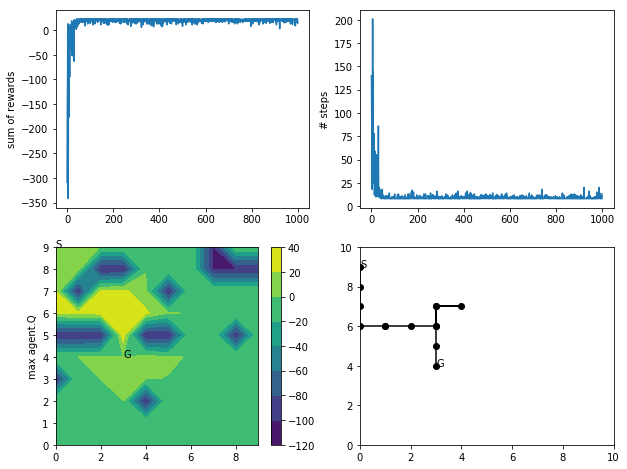

In [28]:
plot_train(agent, rtrace, steps, trace, [0,0])

[0 9]


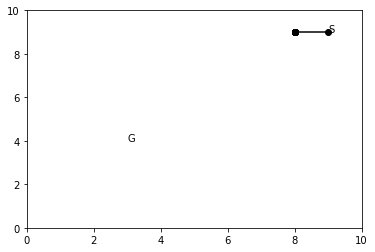

In [29]:
test_start = [0,9]
test_trace = agent.test(test_start)
plot_trace(agent, test_start, test_trace)

[9 9]


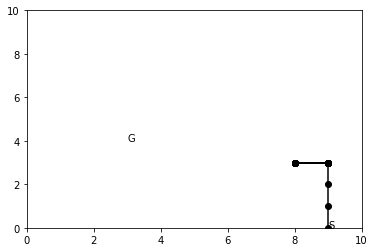

In [30]:
test_start = [9,9]
test_trace = agent.test(test_start)
plot_trace(agent, test_start, test_trace)

[9 0]


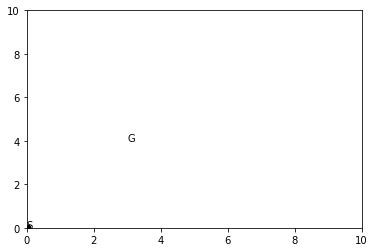

In [31]:
test_start = [9,0]
test_trace = agent.test(test_start)
plot_trace(agent, test_start, test_trace)

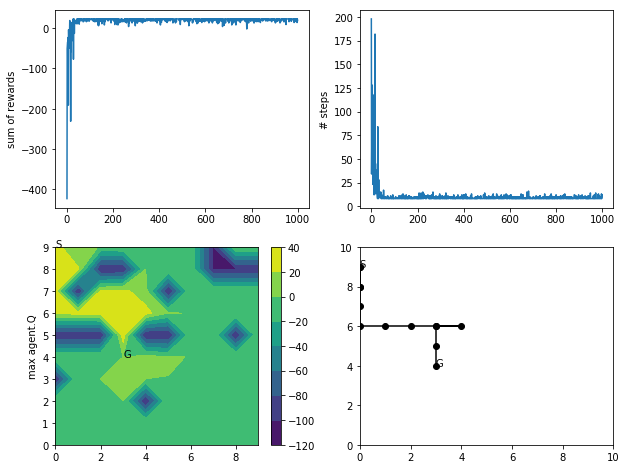

In [32]:
plot_train(agent1, rtrace1, steps1,trace1, [0,0])

[0 9]


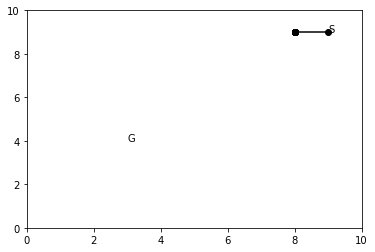

In [33]:
test_start = [0,9]
test_trace = agent1.test(test_start)
plot_trace(agent1, test_start, test_trace)

[9 9]


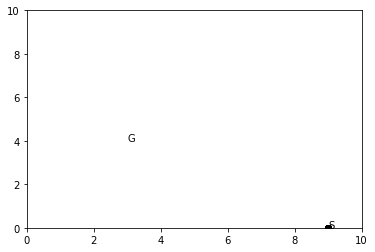

In [34]:
test_start = [9,9]
test_trace = agent1.test(test_start)
plot_trace(agent1, test_start, test_trace)

[9 0]


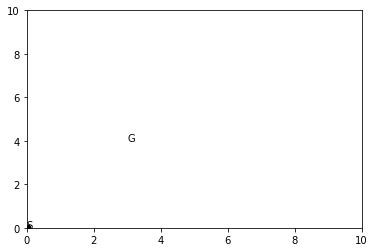

In [36]:
test_start = [9,0]
test_trace = agent1.test(test_start)
plot_trace(agent1, test_start, test_trace)

### Tune $\gamma$

* So as you can see as we decrease the gamma, we are getting more negative Q values for states. It is doing like this because we are multipying gamma with next state previous old value and we substract our current state Q value for upateing current state Q learning. From the plot, I am prrety sure that to get best result gamma should be between 0.9 to 1.

In [37]:
gamma_agent = RLAgent(env)
start = [0,0]
grtrace, gsteps, gtrace = gamma_agent.train(start, 
                                   gamma=0.5, 
                                   alpha=0.1, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

In [38]:
gamma_agent1 = RLAgent(env)
start = [0,0]
grtrace1, gsteps1, gtrace1 = gamma_agent1.train(start, 
                                   gamma=0.95, 
                                   alpha=0.1, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

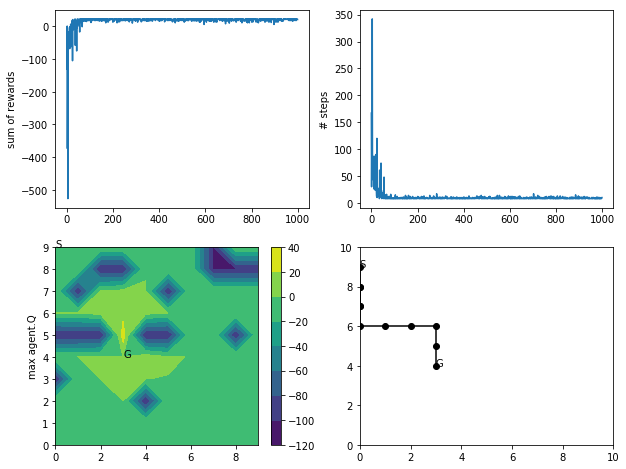

In [39]:
plot_train(gamma_agent, grtrace, gsteps, gtrace, [0,0])

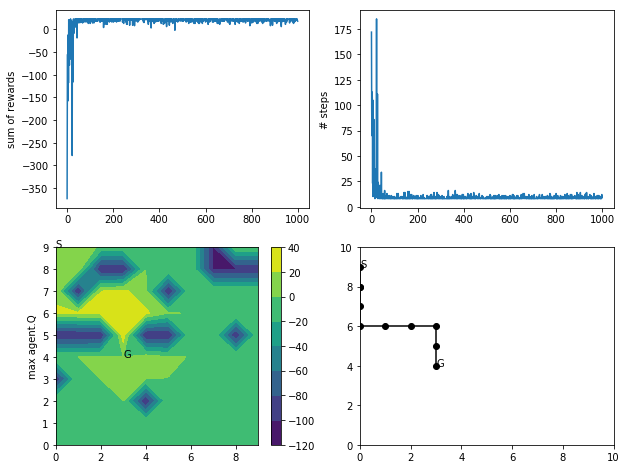

In [40]:
plot_train(gamma_agent1, grtrace1, gsteps1, gtrace1, [0,0])

### Tune $\alpha$
* From below plot we can surely say that learning rate should not be very less otherwise as shown in polt below, we will get Q value very low and pretty much same for every action. So, alpha rate I am thinking best is 0.1.  

In [41]:
alpha_agent = RLAgent(env)
start = [0,0]
artrace, asteps, atrace = alpha_agent.train(start, 
                                   gamma=0.99, 
                                   alpha=1, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

In [42]:
alpha_agent1 = RLAgent(env)
start = [0,0]
artrace1, asteps1, atrace1 = alpha_agent.train(start, 
                                   gamma=0.99, 
                                   alpha=0.01, 
                                   epsilon=0.1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

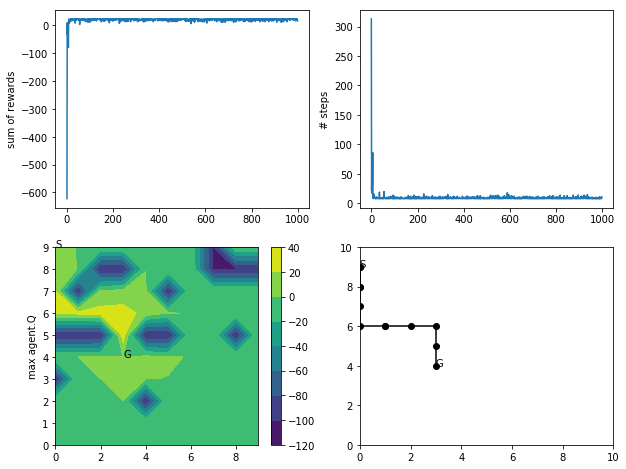

In [43]:
plot_train(alpha_agent, artrace, asteps, atrace, [0,0])

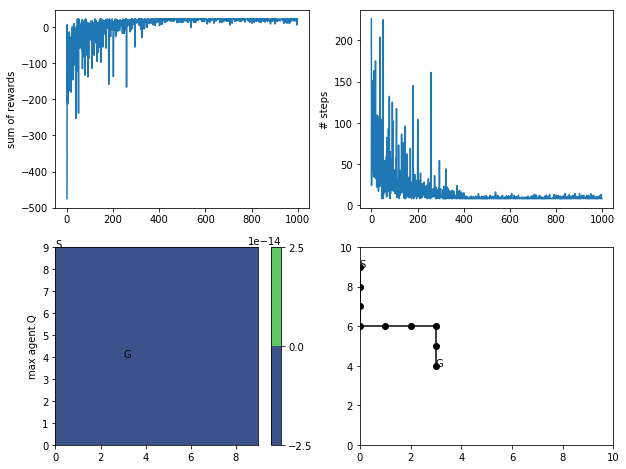

In [44]:
plot_train(alpha_agent1, artrace1, asteps1, atrace1, [0,0])

### Tune $\epsilon$

* It is key parameter to tune in reinforcement learning. There is no point to decrease the epsilon value because generally we are facing problem that our agent doesnot exploring all environment state. So as given below, I train for 0.3 and 1 epsilon value. It is prrety much great. For epsilon 1, we are exploring every state of environment and we are getting good optimal results. As you can see, we are able to find optimal path from every edge of the maze with minimum cost. So, I am taking my epsilon equal to 1.

In [45]:
epsilon_agent = RLAgent(env)
start = [0,0]
ertrace, esteps, etrace = epsilon_agent.train(start, 
                                   gamma=0.99, 
                                   alpha=0.1, 
                                   epsilon=0.3, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

In [46]:
epsilon_agent1 = RLAgent(env)
start = [0,0]
ertrace1, esteps1, etrace1 = epsilon_agent1.train(start, 
                                   gamma=0.99, 
                                   alpha=0.1, 
                                   epsilon=1, 
                                   maxiter=1000,
                                   maxstep=1000, q_learning =True )

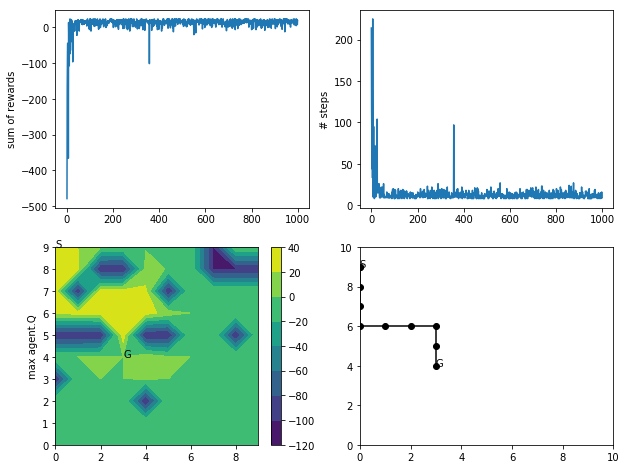

In [47]:
plot_train(epsilon_agent, ertrace, esteps, etrace, [0,0])

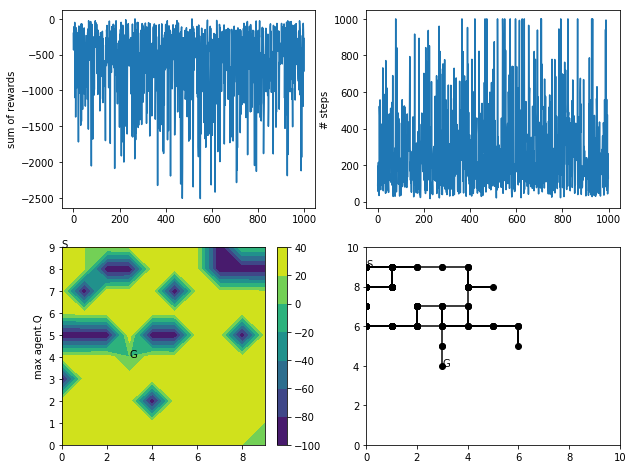

In [48]:
plot_train(epsilon_agent1, ertrace1, esteps1, etrace1, [0,0])

[0 9]


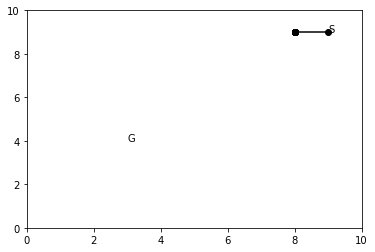

In [49]:
test_start = [0,9]
test_trace = epsilon_agent.test(test_start)
plot_trace(epsilon_agent, test_start, test_trace) # Because there is no roort from there. It is deadlock . 

[9 9]


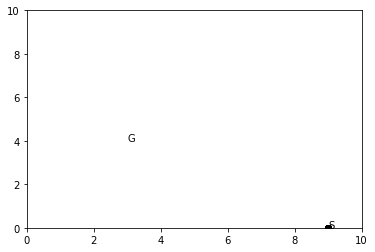

In [50]:
test_start = [9,9]
test_trace = epsilon_agent.test(test_start)
plot_trace(epsilon_agent, test_start, test_trace)

[9 0]


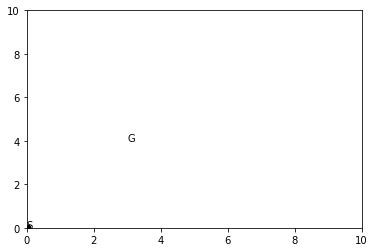

In [51]:
test_start = [9,0]
test_trace = epsilon_agent.test(test_start)
plot_trace(epsilon_agent, test_start, test_trace)

[0 9]


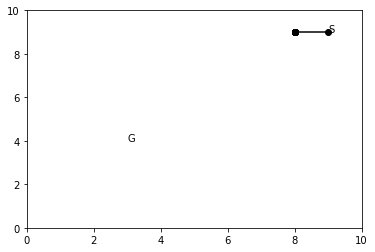

In [54]:
test_start = [0,9]
test_trace = epsilon_agent1.test(test_start)
plot_trace(epsilon_agent1, test_start, test_trace) # Because there is no roort from there. It is deadlock . 

[9 9]


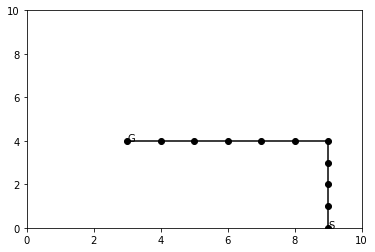

In [53]:
test_start = [9,9]
test_trace = epsilon_agent1.test(test_start)
plot_trace(epsilon_agent1, test_start, test_trace)


[9 0]


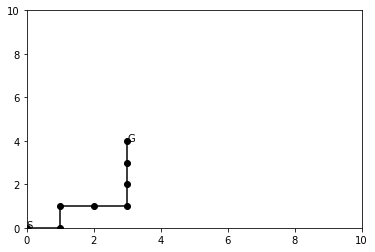

In [52]:
test_start = [9,0]
test_trace = epsilon_agent1.test(test_start)
plot_trace(epsilon_agent1, test_start, test_trace)

## Training and Testing with Poker Agent

In [ ]:
agent = PkAgent()
agent.train(gamma=0.99, 
        alpha=0.1, 
        epsilon=0.5, 
        maxiter=10000,
        q_learning =True)

In [56]:
agent.test()

************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 8.0
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer bot

In [57]:
agent1 = PkAgent()
agent1.train(gamma=0.99, 
        alpha=0.1, 
        epsilon=1, 
        maxiter=10000,
        q_learning =True)

agent
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End gam

Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 6)]
Winner: computer
Printing winning p

Winner: draw
Active player cards: [('computer1', 12), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 8)]

Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer a

Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 fol

Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max an

Active player cards: [('computer1', 9), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, 

Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 13)]
Winner: draw
Active player cards: [('computer1', 13), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 3.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
c

computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions fo

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 4)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: co

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 9)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 7)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
co

Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
W

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
a

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active 

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active i

Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
**************************************

Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Ch

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actio

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 11)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('a

Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Ma

Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 8)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Pla

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player car

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer acti

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11

Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 3)]
Printing winning players: computer1
Reward : -3
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Co

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: compute

Active player cards: [('computer1', 11), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active,

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 9)]
Printing winning players: computer1 agent
Re

Winner: draw
Active player cards: [('computer1', 13), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 5)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('a

computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
c

computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Wi

computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player B

Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
A

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning

agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Play

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
*****

Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 

Active player cards: [('computer1', 2), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]


computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 11)]
Winner: draw
Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer ac

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 13)]
Winner: player
Printing winning players: agent
Rewa

Winner: draw
Active player cards: [('computer1', 3), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 5)]
Printing winning players: agent
Reward : 4.0
Removing player

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 4)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 10)]
Winner: computer
Printing winning players: comput

Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 9)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 8)]
Printing wi

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 5)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.

agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 fold

Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, P

Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Play

computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: age

Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 4)]
Winner: draw
Active player cards: [('computer1', 4), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available 

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent

Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 1.


Winner: draw
Active player cards: [('computer1', 13), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for 

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 8)]
Winner: draw
Active player cards: [('computer1', 8), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 3.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 6), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: comp

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 13)]
Printing winning players: agent

Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1
Rew

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Num

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 12)]
Printing winning

Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('comput

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 10)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no lo

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
R

Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2,

Active player cards: [('computer1', 10), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Rew

Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 10)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are

Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 6)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 

Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 3)]
Printing winning players: computer1
Reward : -2
Player does

computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will mat

agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agen

agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 3.0
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 

Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for:

Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will ma

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 3)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions fo

Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 5)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Chec

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available action

Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2


Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and

Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 13)]
Printing winning players: computer1 agen

Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
comput

Winner: draw
Active player cards: [('computer1', 4), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!

Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 

Winner: draw
Active player cards: [('computer1', 6), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Comput

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: com

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0

Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Chec

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Compu

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), (

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for 

Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for:

Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are 

Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are 

computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 7)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player 

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 11)]
Printing winning players: com

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 6)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2

Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Check results

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
age

Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
A

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !


Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Compu

Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Co

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1

Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 4)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 f

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing 

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Wi

Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0

Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.


Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 11)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Nu

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Compu

Active player cards: [('computer1', 3), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 6)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !


agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match 

Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 3)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: c

Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Pla

Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 12)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Compute

computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check result

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player 

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing w

Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Comp

Active player cards: [('computer1', 10), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 12)]
Printing winning players: computer1
Reward : -4
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winnin

computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check 

Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
comp

Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 8)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: com

Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning

Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: comp

Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available a

Winner: draw
Active player cards: [('computer1', 8), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 2)]
Printing w

Active player cards: [('computer1', 11), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 2)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
age

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 13)]
Printing winning players: computer1 agent
Rew

Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 12)]
Winner: play

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player ac

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player


Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 13)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
comput

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Availab

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
**********************************

Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 5)]
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
com

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Availa

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 7)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer ac

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Rewa

Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 5)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Ma

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player ac

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 13)]
Winner: draw
Active player cards: [('computer1', 13), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning 

Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Ro

Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing w

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no lo

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 5)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player ac

Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 8)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions f

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 8)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Comput

agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 10)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
a

Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: d

Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.


Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 7)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 

Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Co

Active player cards: [('computer1', 8), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: compu

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1

Winner: draw
Active player cards: [('computer1', 8), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13

Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: compu

Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Av

Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
c

Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning 

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Com

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds

computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('c

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Rou

computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active 

Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Rew

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player a

Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 9)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: compu

computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active,

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
co

agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Pl

Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing 

Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.


Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for

Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players:

Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Prin

Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Comp

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 7)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player 

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 4)

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.


agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1

Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and C

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 7)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds

Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Roun

agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer a

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent 

Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 

Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, co

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number:

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: c

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player 

Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number:

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for R

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 8)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
A

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 7)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: comp

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 3.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 6)]
Printing w

computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players:

Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 5)]
Printing winning players: computer1
Reward : -4
Player doesnt

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 2)]
Printin

Winner: draw
Active player cards: [('computer1', 12), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: age

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 ar

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1
Reward : -4
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1


agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0]
computer1 f

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !

computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 11)]
Winner: draw
Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 5)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Avail

************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 6)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check result

computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Roun

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active 

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 7)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 a

Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 12)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check resul

Winner: draw
Active player cards: [('computer1', 3), ('agent', 6)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winn

computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Comput

Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 8
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Com

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
C

agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 8)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer fo

Winner: draw
Active player cards: [('computer1', 6), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: com

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0

Winner: draw
Active player cards: [('computer1', 6), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Numbe

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 8)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for 

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 6)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
compute

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: com

agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 5)]
Winn

Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Ch

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 6)]
Winner: draw
Active player cards: [('computer1', 6), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Availa

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 

Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.

Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 4)]
Winner: computer
Printing winning players: compute

Winner: draw
Active player cards: [('computer1', 12), ('agent', 10)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Playe

Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 8)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward

Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
com

Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !


************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winne

Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Comput

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning playe

Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player activ

Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Availab

Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to 

Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active 

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
ag

Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds,

Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for:

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent',

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Ac

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 4)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions

Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match

Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer fold

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0

Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Playe

computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: compu

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !


Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer a

Active player cards: [('computer1', 2), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 7)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 12)]
Winner: play

agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 play

Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 10)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('c

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 10)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Compute

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 8)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: agent
Reward : 6.0
agent folds
Available acti

Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Co

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 3)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
com

Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing wi

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2

Active player cards: [('computer1', 10), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 9)]
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
comp

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round

Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 3)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actio

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 5)]
Printing winning players: agent
Reward : 8.0
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
compu

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: p

Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 4)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Num

computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 10)]
Winner: player
Printing

computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Re

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 10)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End gam

Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !


Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 

Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 2.0
agent plays 1.
Available actions 

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2

Winner: draw
Active player cards: [('computer1', 3), ('agent', 13)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 9)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for

Active player cards: [('computer1', 5), ('agent', 5)]
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 9)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: com

Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winne

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 7)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now 

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max,

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 ar

Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Nu

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 11)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Avai

Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results fo

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 

Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('compute

Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 8)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Comp

Winner: draw
Active player cards: [('computer1', 2), ('agent', 8)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 4.0
agent 

Active player cards: [('computer1', 11), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Win

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 2.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: 

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Co

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1',

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds


Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]


computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 12)]

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
Removing player: computer1 due to insufficient funds !!
***********

computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 4)]
Winner: draw
Active player cards: [('computer1', 4), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 5)]
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: 

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players

Active player cards: [('computer1', 9), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Co

Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing 

Active player cards: [('computer1', 4), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check 

Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer fo

Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Play

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning p

Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 8)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
Removing player: comput

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions fo

Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 13)]
Winner: draw
Active player cards: [('computer1', 13), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -

Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 6), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Com

computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 9)]
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: 

Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 6)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both B

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !


Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
C

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 9)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players

Reward : -4
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Av

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer act

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [

Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 6)]
Printing winning players: computer1
Reward : -4
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are

agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 7)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Che

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 8)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: comp

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Play

agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Pr

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 3)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 6)]
Winner: computer
Printing

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: 

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 9)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
compute

Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Chec

computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds,

Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1

computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer acti

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1


Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 9)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: 

Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: compu

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
compute

Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !

Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
W

Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 

Active player cards: [('computer1', 4), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4


agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 4)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Availab

Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 13)]
Winner: player
Printing winning pla

Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 8)]
Printing win

Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 2)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Nu

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 13)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 10)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !


computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 8)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round 

computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Be

Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Pl

Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds

Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available a

Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1,

Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results

Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: dr

agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
a

Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1]
com

Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 9)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 9)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 7)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Avail

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player fo

computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 6)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 9)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: pla

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 6)]
Pri

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 4)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 pl

Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 2.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both 

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results 

Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 5)]
Winner: player
Printing winning players: agent
Reward :

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 2)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Num

Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 3), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: d

computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 10)]
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 10)]
Printing winning players: computer1
Reward : -

Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer


Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 4)]
Winner: computer
Printing winning players: compute

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
C

computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Compute

computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 5), ('agent', 7)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: 

Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 3.
Available acti

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check resu

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 11)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for R

Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 3.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Be

Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, P

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 3)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 11)]
Printing winning players: agent
Reward : 

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 8)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 11)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Print

computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 2.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, P

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer acti

Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 11)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 9)]
Winner: player

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active 

Active player cards: [('computer1', 13), ('agent', 10)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insuffi

Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 7)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 12)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available act

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 4)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 3)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -

Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Ro

Winner: draw
Active player cards: [('computer1', 10), ('agent', 11)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 2.
Available actions for: compu

Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 2)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 13)]
Printing 

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
A

Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are 

Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: com

agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: ag

Active player cards: [('computer1', 13), ('agent', 6)]
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for R

agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.

Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 7)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both

Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: 

Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 9)]
Printin

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check resul

Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 5)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning play

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 5), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions 

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: comput

Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 13), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Acti

Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 10)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 4),

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! E

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 13)]
Winner: player
Printing winning 

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 10)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Nu

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 8)]
Printing winning players: agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Act

Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 9)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 5)]
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active 

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 7)]
Printing winning players: agent
Reward : 6.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 6)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in

Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer fold

agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 4)]
Printing winning players: computer1
Reward : -3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
com

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 2), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 11)]
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check r

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 8), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 6), ('agent', 9)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number:

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('compute

agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 2)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
C

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 4), ('agent', 5)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 13), ('agent', 6)]
Winner: computer
Prin

Available actions for: computer1 are [0, 2]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 10)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 

Reward : 2.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions fo

Active player cards: [('computer1', 4), ('agent', 10)]
Printing winning players: agent
Reward : 6.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 13), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 2.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0,

Reward : -4
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 6)]
Winner: draw
Active player cards: [('computer1', 6), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2

Active player cards: [('computer1', 10), ('agent', 4)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and C

Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1

Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 3)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('com

Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player and Computer both Bet M

Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 2)]
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 3.
Available acti

Winner: draw
Active player cards: [('computer1', 5), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round 

Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 8)]
Printing winning players: agent
Reward : 6.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 2.
Available actions for: compu

Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [

Winner: draw
Active player cards: [('computer1', 8), ('agent', 10)]
Printing winning players: agent
Reward : 8.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 4)]
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 3), ('agent', 5)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available

Winner: player
Printing winning players: agent
Reward : 4
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 10), ('agent', 6)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balanc

Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 10)]
Printing winning players: agent
Reward : 8.0
agent folds
Available actions for: comp

Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available ac

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 6)]
Printing winning players: computer1
Reward : -2
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 2), ('agent', 7)]
Printing winning players: agent
Reward : 4.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer b

Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 8), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Rou

agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 7), ('agent', 3)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 7), ('agent', 5)]
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check result

Active player cards: [('computer1', 12), ('agent', 6)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Compu

Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('co

Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent folds
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 12), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
Re

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 8)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 4)]
Winner: computer
Printing winning players: c

Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.


Printing winning players: agent
Reward : 6
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 10), ('agent', 10)]
Winner: draw
Active player cards: [('computer1', 10), ('agent', 10)]
Printing winning players: computer1 agent
Reward : 4.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check result

Reward : 5
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 6), ('agent', 8)]
Winner: player
Printing winning players: agent
Reward : 6
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 12)]
Printing winning players: agent
Reward : 6.0
agent folds
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Print

Active player cards: [('computer1', 2), ('agent', 11)]
Winner: player
Printing winning players: agent
Reward : 8
agent folds
Available actions for: computer1 are [0]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 6), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
Removing player: computer1 due to insufficient funds !!
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End ga

Winner: computer
Printing winning players: computer1
Reward : -1
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 7), ('agent', 7)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 3), ('agent', 12)]
Printing winning players: agent
Reward : 8.0
agent f

Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 3)]
Printing winning players: computer1
Reward : -3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 9)]
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: co

Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 9), ('agent', 12)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Check results for Round Number: 1
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -1
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('

agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 9), ('agent', 13)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 11), ('agent', 8)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 

agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 10), ('agent', 5)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 12), ('agent', 13)]
Printing winning players: agent
Reward : 8.0
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round

computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 8), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 8
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 6), ('agent', 13)]
Printing winning players: agent
Reward : 4.0
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 2), ('agent', 2)]
Printing winn

Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 11), ('agent', 10)]
Printing winning players: computer1
Reward : -3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 2.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 5
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active i

Printing winning players: computer1
Reward : -3
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 4), ('agent', 5)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 11), ('agent', 5)]
Winner: computer
Printing winning players: computer1
Reward : -4
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
agent folds
Check results for Round Number: 2
Computer active, Player folds !
Winner: computer
Printing winning players: computer1
Reward : -2
Player doesnt have balance !
agent can no longer play the game !
************************************************************
agent plays 2.
Availab

computer1 folds
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 3
agent plays 1.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
agent plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 9), ('agent', 12)]
Winner: player
Printing winning players: agent
Reward : 6
agent folds
Available actions for: computer1 are [0, 1, 2, 3]
computer1 folds
Check results for Round Number: 1
Computer folds, Player folds !
Winner: draw
Active player cards: [('computer1', 6), ('agent', 4)]
Printing winning players: computer1 agent
Reward : 1.0
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Playe

In [58]:
agent1.test()

************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 plays 1.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 13)]
Winner: player
Printing winning players: agent
Reward : 8
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 3.
Player and Computer both Bet Max and match !
Check results for Round Number: 1
Computer active, Player active ! 
Winner: draw
Active player cards: [('computer1', 5), ('agent', 11)]
Printing winning players: agent
Reward : 8.0
************************************************************
agent plays 3.
Available actions for: computer1 are [0]
computer1 folds
Player and Computer both Bet Max and ma

In [ ]:
agent2 = PkAgent()
agent2.train(gamma=0.99, 
        alpha=0.1, 
        epsilon=0.75, 
        maxiter=10000,
        q_learning =True)

In [60]:
agent2.test()

************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 2]
computer1 plays 2.
Check results for Round Number: 2
Computer active, Player active in Round 2 ! End game now !
Active player cards: [('computer1', 12), ('agent', 2)]
Winner: computer
Printing winning players: computer1
Reward : -4
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 2.
Player Bet Max, computer will match now !
Available actions for: computer1 are [0, 1]
computer1 folds
Check results for Round Number: 2
Computer folds, Player active !
Winner: player
Printing winning players: agent
Reward : 7
************************************************************
agent plays 3.
Available actions for: computer1 are [0, 1, 2, 3]
computer1 plays 1.
Player Bet Max, compu

## Parameter for Maze Problem: 

gamma : 0.99    
alpha rate : 0.1    
epsilon :1    
maxiter : 1000    
maxstep : 1000    
method : Q_learning     

## Parameter for Poker Game:

gamma : 0.99       
alpha rate : 0.1       
epsilon :0.75     
maxiter : 10000    
method: Q_learning

##  How do you choose them?

* I as shown in upper plots did try and test to tune parameter. I observe at particular parameter, how my agent is exploring the environment and how it is updating the values of Q value. After training and plotting the Q value , step , reward and trace, I also test my agent with edges of the maze because that the part which can be left with exploration in most general case.

## Reading and analysis of learning results and plots:

1. Maze Problem:

 * First plot is showing, how much reward we are getting per episode. Second plot is showing how much step we are going before reachinh the goal state means how fast we are convergeing. 
 * Third plot is very key plot. It is showing what is the Q value at particular state. From that we can assume that how much our agent explore the environment. Like if it is full of yellow then we can surely trust our agrnt to get optimal solution from any state in the environmnet. Fourth plot shows our training journey from starting state to goal state. From this also we can say how our agent wander in environment.

2. Poker Game:
 
 * As you can say that I train my agent for different epsilon value. Alpha, gamma and maxiter is not make much difference. So I did nit check for different value. I took maxiter 10000. There is big disadvantage in taking small maxiter and epsilon. It will mostly fold because Q value is not updated in most of the state. For big epsilon  it perform good and it also beat the computer but it is betting 3 most of the time because it is taking most of the action randomly. So, it is not that great agent.


# V. Conclusions

* I learned to make an agent using TD learning reinforcemnet learning agent. I also learned two method of TD learning q-learning and sarsa. Also I learned which algorithm we can use at what situation. 
* From ploting different result and  using differnent parametere value, I come to know what is the affect of epsilon, gamma and alpha rate on the result.
* I also made rl agent for solving maze problem and Poker game.

# Extra Credit

- Let us have Poker Tournament in class (Nov 6th.)!
- Top 4 (or more) students will get an extra credit. 
- 2 (or more?) unique training attemps will also get an extra credit. (Sales for it to be considered.) 

## Grading

We will test your notebook with an additional grid.txt file. Please make sure to test in different maze input files. 

points|--| description
--|--|:--
5 | Overview| states the objective and the appraoch 
10|--|Maze Problem
 | 5| Includes description of maze problem
 | 5| Explains the GridWorld
10|--| Poker 
 | 5| Includes description of poker problem
 | 5| Explains the Poker
25 |-- |Methods  
 --| 5| Review of the SARSA and Q-Learning
 --| 5| Choice of TD learning and Reason
 --|10| Implementation of the selected approach
 --| 5| explanation of the codes
45|-- | Results 
--| 5| Reports the selected parameters for both problems. 
--|20| Experimental outputs that show the choice of parameters. How do you choose them? (10 points per each problem)
--|10| Output plots (5 for each)
--|10| reading and analysis of learning results and plots (5 for each)
5|--| Conclusions 
